# Satellite Image Classification: Extracting More from Less



In [2]:
import os
import matplotlib.pyplot as plt
from skimage.io import imread, imshow
from skimage.color import rgb2gray, rgb2hsv, rgb2lab

In [3]:
base_path = "./dataset/"

In [4]:
from zipfile import ZipFile

with ZipFile(base_path + "EuroSAT.zip", "r") as zObject:
	zObject.extractall(path=base_path)

In [5]:
base_path = base_path + "EuroSAT/"
categories = os.listdir(base_path)

## EDA

Before entering into extracting features and applying algorithms amb benchmarks we first need to do an Exploratory Data Analysis to know how we can work with the dataset.

### Image composition

First and foremost, it's important to visualize the images and know the dimensions of them. As we can see in the example below, the images are of size 64x64 pixels with 3 spectral bands. To the human eye the resolution is quite deceibing, but we can get a lot of information from it.

(64, 64, 3)


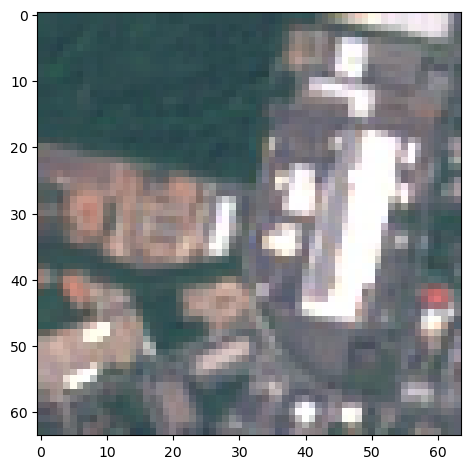

In [6]:
im = imread(base_path + "Industrial/Industrial_1.jpg")
print(im.shape)
imshow(im)

We can also convert the original image to diferent color contexts, like grayscale, black & white, cielab or hsv.

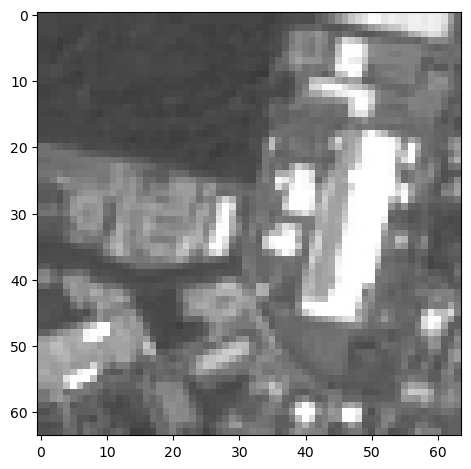

In [7]:
im_gray = rgb2gray(im)
imshow(im_gray)

A part from the visual point of view, we need to know how the data of the image is structured in the different color spaces.

In [8]:
list(im_gray)

[array([0.28510941, 0.28453608, 0.2789251 , 0.26803137, 0.27114235,
        0.26803137, 0.27108196, 0.26968314, 0.27783176, 0.28175333,
        0.27752627, 0.27583686, 0.26968314, 0.27783176, 0.27277137,
        0.2789251 , 0.2856749 , 0.29237922, 0.26968314, 0.27108196,
        0.25539569, 0.25931725, 0.27500353, 0.27697569, 0.28372549,
        0.27923843, 0.2739102 , 0.27108196, 0.26799373, 0.27191529,
        0.27191529, 0.26799373, 0.27696078, 0.27191529, 0.25341569,
        0.25063294, 0.26772588, 0.29461137, 0.3005051 , 0.31257529,
        0.30081059, 0.29461137, 0.36652314, 0.39779059, 0.46215059,
        0.56154392, 0.65505765, 0.76707804, 0.8344502 , 0.88858706,
        0.9822749 , 0.97022667, 0.89683216, 0.93268392, 0.91086667,
        0.9041851 , 0.93388314, 0.94310235, 0.91143216, 0.93970941,
        0.92264706, 0.86918157, 0.61710706, 0.40817765]),
 array([0.28708157, 0.28453608, 0.2789251 , 0.26913255, 0.27027137,
        0.26969804, 0.26716039, 0.26968314, 0.27726627, 0.

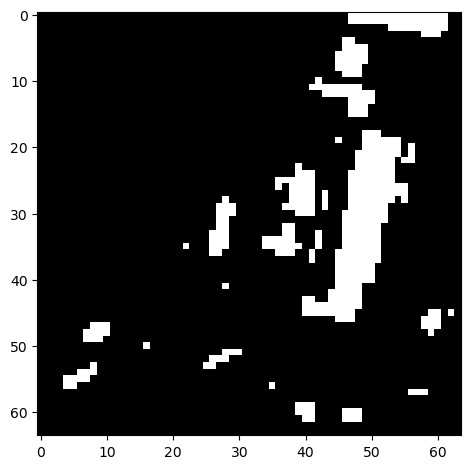

In [9]:
im_bw = im_gray > 0.75
imshow(im_bw)

In [10]:
list(im_bw)

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False,  True,  True,  True,  True,  True,  True,  True,
         True,  True,  True,  True,  True,  True,  True,  True, False,
        False]),
 array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False,  True,  True,  True,  True,  True,  True,  True,
         True,  True,  True,  True,  True,  True,  True,  Tr

In [11]:
list(rgb2lab(im))

[array([[ 31.53746469, -12.61570964,  -3.3094943 ],
        [ 31.37982278, -10.83473365,  -4.80729769],
        [ 30.71175744,  -9.63530736,  -5.80380538],
        [ 29.67139064, -10.53885353,  -6.75377186],
        [ 30.20067593, -12.57266503,  -5.9763278 ],
        [ 29.67139064, -10.53885353,  -6.75377186],
        [ 29.85514426,  -9.6387531 ,  -5.81234984],
        [ 29.72700568, -10.53904209,  -4.72219718],
        [ 30.75588706, -12.04126601,  -4.48080727],
        [ 31.18105196, -12.03909747,  -4.48220748],
        [ 30.58358648, -10.53142684,  -4.71952712],
        [ 30.34221868,  -9.32313945,  -5.71483539],
        [ 29.72700568, -10.53904209,  -4.72219718],
        [ 30.75588706, -12.04126601,  -4.48080727],
        [ 30.09957814, -10.84491321,  -4.81052825],
        [ 30.71175744,  -9.63530736,  -5.80380538],
        [ 31.60541554, -12.0365185 ,  -4.48344384],
        [ 32.22917697, -10.82638927,  -4.80460099],
        [ 29.72700568, -10.53904209,  -4.72219718],
        [ 29

In [12]:
images = []
for cat in categories:
	files = os.listdir(base_path + cat)
	images.append(imread(base_path + cat + "/" + files[0]))

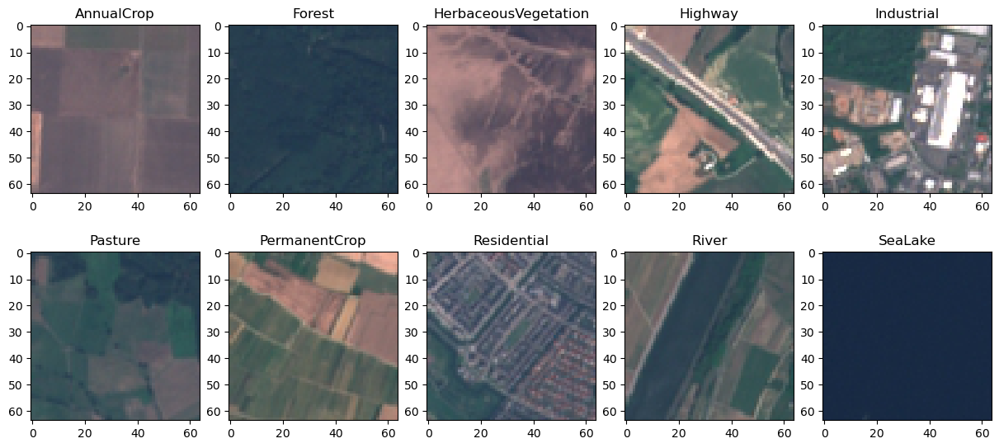

In [13]:
_, axs = plt.subplots(2, 5, figsize=(12, 5.5), layout="constrained")
axs = axs.flatten()
for i, cat in enumerate(categories):
	axs[i].imshow(images[i])
	axs[i].set_title(cat)
plt.show()

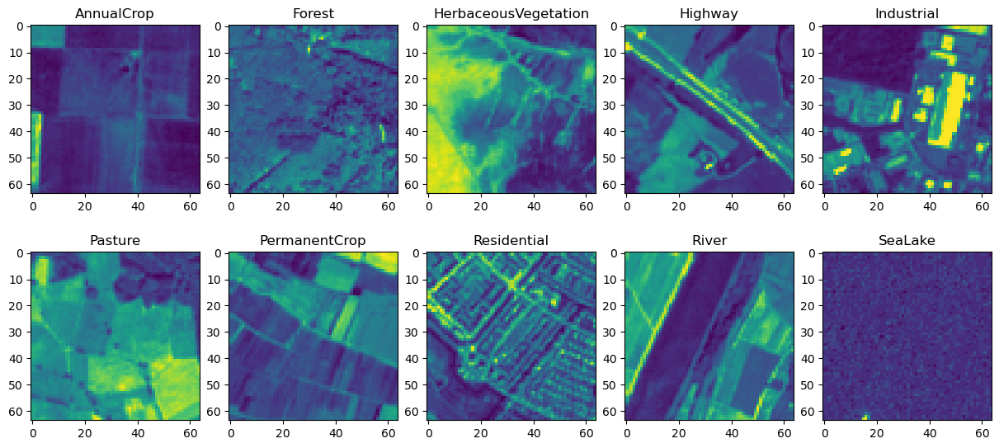

In [14]:
_, axs = plt.subplots(2, 5, figsize=(12, 5.5), layout="constrained")
axs = axs.flatten()
for i, cat in enumerate(categories):
	axs[i].imshow(rgb2gray(images[i]))
	axs[i].set_title(cat)
plt.show()

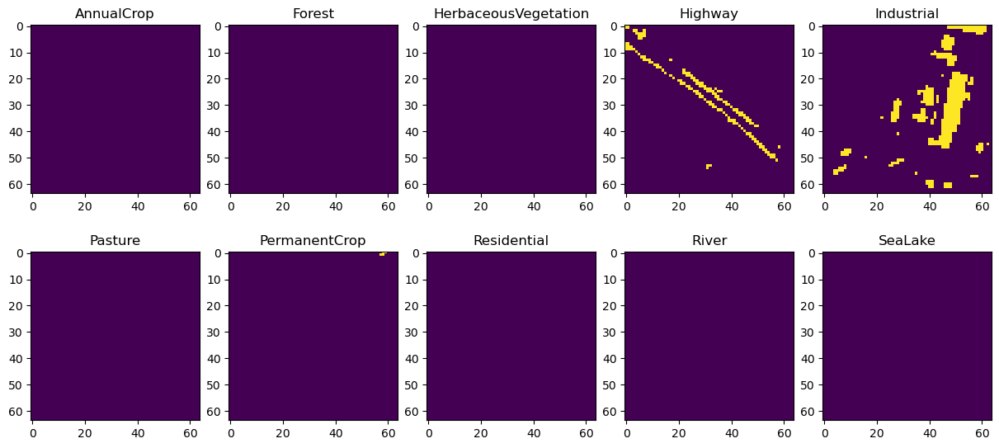

In [15]:
_, axs = plt.subplots(2, 5, figsize=(12, 5.5), layout="constrained")
axs = axs.flatten()
for i, cat in enumerate(categories):
	axs[i].imshow(rgb2gray(images[i]) > 0.75)
	axs[i].set_title(cat)
plt.show()

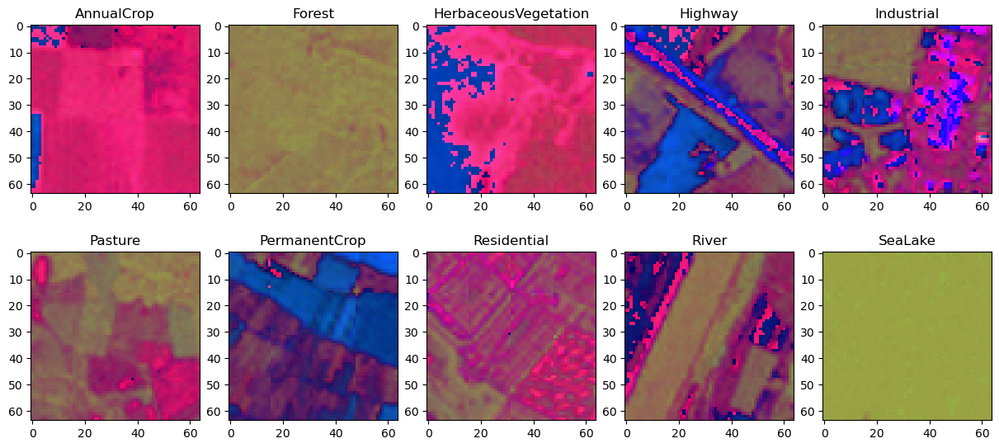

In [16]:
_, axs = plt.subplots(2, 5, figsize=(12, 5.5), layout="constrained")
axs = axs.flatten()
for i, cat in enumerate(categories):
	axs[i].imshow(rgb2hsv(images[i]))
	axs[i].set_title(cat)
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-7.550006397646769..69.2566430029738].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-17.38786721869401..34.521295747088956].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-12.82236002644963..65.78079625523823].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-17.840593573423075..99.65437456863168].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-17.471588022276023..100.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-17.180487870308692..45.49108506732022].
Clipping input data to the valid range for 

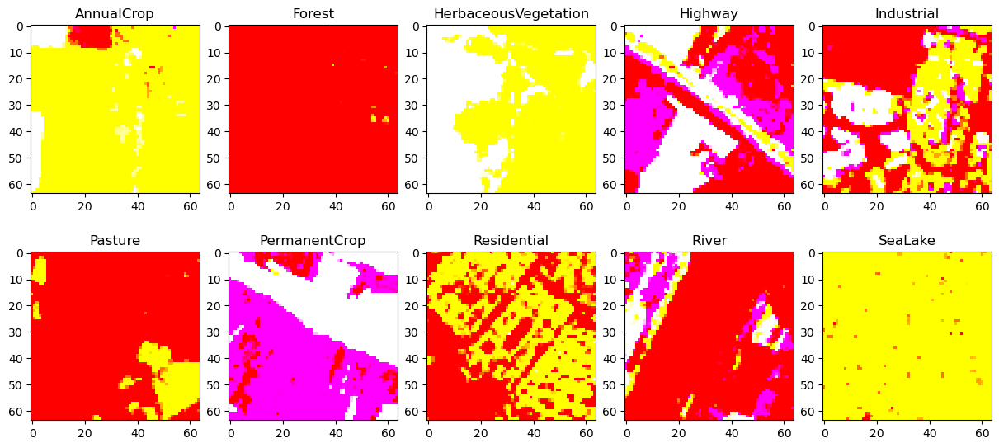

In [17]:
_, axs = plt.subplots(2, 5, figsize=(12, 5.5), layout="constrained")
axs = axs.flatten()
for i, cat in enumerate(categories):
	# axs[i].imshow((rgb2lab(images[i]) - rgb2lab(images[i]).min()) / (rgb2lab(images[i]).max() - rgb2lab(images[i]).min())) Normalized values for visualization (not accurate)
	axs[i].imshow(rgb2lab(images[i]))
	axs[i].set_title(cat)
plt.show()

If we show an example of each category in all the diferent color spaces that we want to work with, we can start to see some differences that may indicate that some categories will be easier to classify than others, since the information of the image is quite different from the rest of the categories. But as we know, that's the job of the algorithm, here it's important to identify how and which features we can extract.

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-7.550006397646769..69.2566430029738].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-17.38786721869401..34.521295747088956].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-12.82236002644963..65.78079625523823].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-17.840593573423075..99.65437456863168].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-17.471588022276023..100.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-17.180487870308692..45.49108506732022].
Clipping input data to the valid range for 

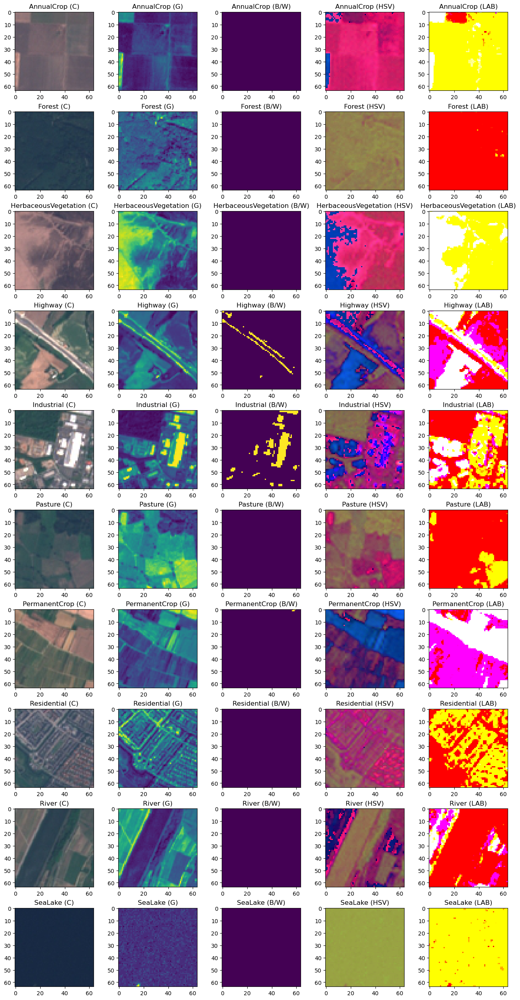

In [18]:
_, axs = plt.subplots(10, 5, figsize=(13,25), layout="constrained")
axs = axs.flatten()

for i, cat in enumerate(categories):
	files = os.listdir(base_path + "/" + cat)
	image = imread(base_path + "/" + cat + "/" + files[0])
	
	axs[i*5 + 0].imshow(image)
	axs[i*5 + 1].imshow(rgb2gray(image))
	axs[i*5 + 2].imshow(rgb2gray(image) > 0.75)
	axs[i*5 + 3].imshow(rgb2hsv(image))
	axs[i*5 + 4].imshow(rgb2lab(image))
    
	axs[i*5 + 0].set_title(f"{cat} (C)")
	axs[i*5 + 1].set_title(f"{cat} (G)")
	axs[i*5 + 2].set_title(f"{cat} (B/W)")
	axs[i*5 + 3].set_title(f"{cat} (HSV)")
	axs[i*5 + 4].set_title(f"{cat} (LAB)")
	
plt.show()

As previously mentioned, the original images are in 3 spectral bands (RGB). A good representation of the color data is to use a histogram, this way we can visualize the color distribution and decide to apply different color features.

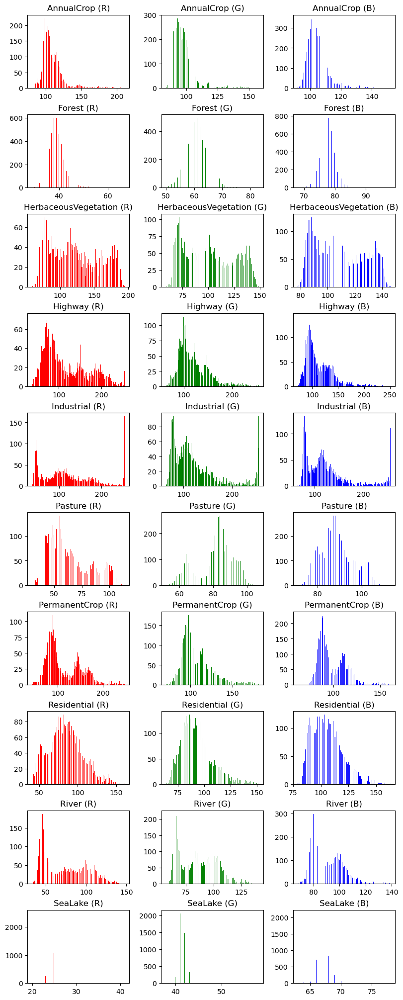

In [19]:
_, axs = plt.subplots(10, 3, figsize=(8, 20), layout="constrained")
axs = axs.flatten()

for i, cat in enumerate(categories):
    files = os.listdir(base_path + "/" + cat)
    image = imread(base_path + "/" + cat + "/" + files[0])
    
    r_vals = image[:, :, 0].flatten()
    g_vals = image[:, :, 1].flatten()
    b_vals = image[:, :, 2].flatten()
    
    r_ax = axs[i*3 + 0]  
    g_ax = axs[i*3 + 1]  
    b_ax = axs[i*3 + 2]  
    
    r_ax.hist(r_vals, bins=256, color='red')
    g_ax.hist(g_vals, bins=256, color='green')
    b_ax.hist(b_vals, bins=256, color='blue')
    
    r_ax.set_title(f"{cat} (R)")
    g_ax.set_title(f"{cat} (G)")
    b_ax.set_title(f"{cat} (B)")

plt.show()

And to end up, it's essential to know how the dataset is distributed and populated. In this particular dataset, all categories have between 2000 and 3000 images, this important difference indicates that the dataset is not quite balanced. Maybe it would be interesting to take this into account when dealing with the train, test splits.

In [20]:
sizes = []
length = {}

for cat in categories:
	files = os.listdir(base_path + cat + "/")
	print(files)
	length[cat] = len(files)
	for image in files:
		im = imread(base_path + cat + "/" + image)
		shape = im.shape
		if shape not in sizes:
			sizes.append(shape)

print(sizes)
print(length)

['AnnualCrop_1.jpg', 'AnnualCrop_10.jpg', 'AnnualCrop_100.jpg', 'AnnualCrop_1000.jpg', 'AnnualCrop_1001.jpg', 'AnnualCrop_1002.jpg', 'AnnualCrop_1003.jpg', 'AnnualCrop_1004.jpg', 'AnnualCrop_1005.jpg', 'AnnualCrop_1006.jpg', 'AnnualCrop_1007.jpg', 'AnnualCrop_1008.jpg', 'AnnualCrop_1009.jpg', 'AnnualCrop_101.jpg', 'AnnualCrop_1010.jpg', 'AnnualCrop_1011.jpg', 'AnnualCrop_1012.jpg', 'AnnualCrop_1013.jpg', 'AnnualCrop_1014.jpg', 'AnnualCrop_1015.jpg', 'AnnualCrop_1016.jpg', 'AnnualCrop_1017.jpg', 'AnnualCrop_1018.jpg', 'AnnualCrop_1019.jpg', 'AnnualCrop_102.jpg', 'AnnualCrop_1020.jpg', 'AnnualCrop_1021.jpg', 'AnnualCrop_1022.jpg', 'AnnualCrop_1023.jpg', 'AnnualCrop_1024.jpg', 'AnnualCrop_1025.jpg', 'AnnualCrop_1026.jpg', 'AnnualCrop_1027.jpg', 'AnnualCrop_1028.jpg', 'AnnualCrop_1029.jpg', 'AnnualCrop_103.jpg', 'AnnualCrop_1030.jpg', 'AnnualCrop_1031.jpg', 'AnnualCrop_1032.jpg', 'AnnualCrop_1033.jpg', 'AnnualCrop_1034.jpg', 'AnnualCrop_1035.jpg', 'AnnualCrop_1036.jpg', 'AnnualCrop_1037.jp

## Feature Extraction

Given the previous analysis now we can address how we want to extract features from the data. The feature extraction will follow a pipeline divided by different feature categories:
- Statistical Features
- Texture Features

In [21]:
import numpy as np
import pandas as pd

import random

from scipy.stats import entropy, skew, kurtosis
from skimage.filters import laplace, gaussian, sobel, threshold_otsu, gabor
from skimage.feature import canny, hog
from skimage.feature import graycomatrix, graycoprops, local_binary_pattern
from skimage.measure import shannon_entropy, moments_hu, moments, label, regionprops

### Statistical Features

Statistical moments from each RGB channel and combinations:
- **First-order statistics:** mean, median, standard deviation, variance, sum, skewness, kurtosis
- **Percentile features:** 10th, 25th, 75th, 90th percentiles
- **Range and extrema:** min, max, range, interquartile range
- **Entropy:** Shannon entropy

With a total of **48 features**

In [49]:
def statisticalFeatures(image):
	features = []
	for channel in range(3):
		ch_data = image[:, :, channel]
		features += [
			np.mean(ch_data),
			np.median(ch_data),
			np.std(ch_data),
			np.var(ch_data),
			np.sum(ch_data),
			skew(ch_data.flatten()),
            kurtosis(ch_data.flatten()),

			np.percentile(ch_data, 10),
			np.percentile(ch_data, 25),
			np.percentile(ch_data, 75),
			np.percentile(ch_data, 90),

			np.min(ch_data),
			np.max(ch_data),
			np.max(ch_data) - np.min(ch_data),
			np.percentile(ch_data, 75) - np.percentile(ch_data, 25),

			shannon_entropy(ch_data)
		]
	return features

### Texture Features

Particularly powerful for land use classification:
- **GLCM properties:** contrast, dissimilarity, homogeneity, ASM, energy, correlation

With a total of **72 features**

In [67]:
def textureFeatures(image):
	features = []


	image_gray = rgb2gray(image)
	image_gray = ((image_gray - image_gray.min()) / (image_gray.max() - image_gray.min()) * 255).astype(np.uint8)	# Normalize to 0-255



	distances = [1, 2, 3]
	angles = [0, np.pi/4, np.pi/2, 3*np.pi/4]

	for distance in distances:
		for angle in angles:
			
			glcm = graycomatrix(image_gray, distances=[distance], angles=[angle], levels=256, symmetric=True, normed=True)

			features += [
				graycoprops(glcm, "contrast")[0, 0],
				graycoprops(glcm, "dissimilarity")[0, 0],
				# graycoprops(glcm, "homogeneity")[0, 0],
				# graycoprops(glcm, "ASM")[0, 0],
				# graycoprops(glcm, "energy")[0, 0],
				# graycoprops(glcm, "correlation")[0, 0],
			]

	return features

### LBP Features

- **Local Binary Pattern** histograms and statistics for each RGB channel

With a total of **111 feautres**

In [71]:
def lbpFeatures(image):

	features = []

	radius = 3
	n_points = 8 * radius

	for channel in range(3):

		ch_data = image[:, :, channel]

		lbp = local_binary_pattern(ch_data, n_points, radius, method="uniform")
		hist, _ = np.histogram(lbp.ravel(), bins=n_points + 2, range=(0, n_points + 2))

		features.extend(hist)

		features += [
			np.mean(lbp),
			np.std(lbp),
			np.var(lbp)
		]

	return features

### Gabor Features

- **Gabor filter** responses across diferent frequencies and orientations

With a total of **216 features**

In [90]:
def gaborFeatures(image):
	features = []

	frequencies = [0.1, 0.3, 0.5]
	orientations = [0, np.pi/4, np.pi/2, 3*np.pi/4]

	for channel in range(3):
		channel_data = image[:, :, channel]

		for frequency in frequencies:
			for theta in orientations:

				real, _ = gabor(channel_data, frequency=frequency, theta=theta)

				features += [
					np.mean(real),
					np.std(real),
					np.var(real),
					np.max(real),
					np.min(real),
					shannon_entropy(np.abs(real))
				]

	return features

### Color Space Feautres

- Statistics from **HSV** and **LAB** color spaces

With a total of **30 features**

In [91]:
def colorSpaceFeatures(image):

	features = []

	hsv = rgb2hsv(image)
	lab = rgb2lab(image)

	for channel in range(3):
		hsv_channel_data = hsv[:, :, channel]
		lab_channel_data = lab[:, :, channel]

		feautres += [
			np.mean(hsv_channel_data),
			np.mean(lab_channel_data),
			np.std(hsv_channel_data),
			np.std(lab_channel_data),
			np.var(hsv_channel_data),
			np.var(lab_channel_data),
			skew(hsv_channel_data.flatten()),
			skew(lab_channel_data.flatten()),
			kurtosis(hsv_channel_data.flatten()),
			kurtosis(lab_channel_data.flatten())
		]

	return features

## Feature Pipeline

Once all categorical feature extraction functions are designed, it's required to add them to a complete pipeline to merge all features in a single Data Frame. 

In [92]:
def featureExtraction(image):
	features = []

	features += statisticalFeatures(image)
	features += textureFeatures(image)
	features += lbpFeatures(image)
	features += gaborFeatures(image)
	features += colorSpaceFeatures(image)


	return features

In [83]:
data = []
labels = [] 
names = []

max_per_cat = 3000

for cat in categories:
	print(cat)
	files = os.listdir(base_path + cat + "/")
	random.shuffle(files)
	for i, image in enumerate(files):
		if i == max_per_cat:
			break
		path = base_path + cat + "/" + image
		im = imread(path)
		data.append(featureExtraction(im))
		labels.append(cat)
		names.append(image)

X = np.array(data).astype(np.uint8)

AnnualCrop
Forest
HerbaceousVegetation
Highway
Industrial
Pasture
PermanentCrop
Residential
River
SeaLake


In [85]:
X.shape

(26862, 159)

In [84]:
df = pd.DataFrame(X)

x = X
y = labels
image_paths = names
df["class"] = labels
df["name"] = names
df
print(df.to_string())

         0    1   2    3    4    5    6    7    8    9   10   11   12   13   14  15   16   17  18   19   20   21   22   23   24   25   26   27   28   29   30  31   32   33  34   35   36   37   38   39   40   41   42   43   44   45   46  47   48  49   50  51   52  53   54  55   56  57   58  59   60  61   62  63   64  65   66  67   68  69   70  71   72   73   74   75   76   77   78   79   80   81   82   83   84   85   86   87   88   89   90   91   92   93   94   95   96   97  98  99  100  101  102  103  104  105  106  107  108  109  110  111  112  113  114  115  116  117  118  119  120  121  122  123  124  125  126  127  128  129  130  131  132  133  134  135  136  137  138  139  140  141  142  143  144  145  146  147  148  149  150  151  152  153  154  155  156  157  158                 class                           name
0      120   99  56  155   79    0  255   61   67  189  198   55  217  162  122   6  124  115  24  104   94    0  255   97  100  150  156   90  180   90   50   5  117

## ML Models

Once the Data Frame has been created with all the extracted features, we can use this data to train the classical ML models.

In [79]:
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score, roc_curve, roc_auc_score, auc
from sklearn.preprocessing import StandardScaler, LabelEncoder, label_binarize
from sklearn.decomposition import PCA
from imblearn.over_sampling import SMOTE
from collections import Counter

import seaborn as sns

In [86]:
x = df.drop(columns = ["class", "name"])
y = df["class"]
image_paths = df["name"]
target_names = y.unique()

In [87]:
x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.25, stratify=y)
feature_columns = x_train.columns

In [88]:
rf = RandomForestClassifier()
rf.fit(x_train, y_train)
y_pred = rf.predict(x_test)
accuracy = accuracy_score(y_test, y_pred)

                      precision    recall  f1-score   support

          AnnualCrop       0.84      0.89      0.86       750
              Forest       0.96      0.98      0.97       750
HerbaceousVegetation       0.83      0.78      0.81       750
             Highway       0.69      0.57      0.63       625
          Industrial       0.87      0.92      0.89       625
             Pasture       0.86      0.85      0.86       500
       PermanentCrop       0.75      0.79      0.77       625
         Residential       0.91      0.96      0.93       750
               River       0.77      0.76      0.76       625
             SeaLake       0.97      0.97      0.97       716

            accuracy                           0.85      6716
           macro avg       0.85      0.85      0.85      6716
        weighted avg       0.85      0.85      0.85      6716



<Axes: >

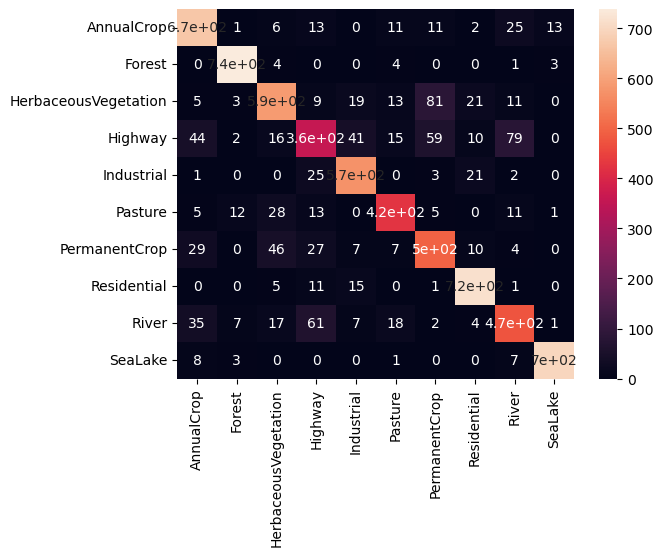

In [89]:
print(classification_report(y_test, y_pred, target_names=target_names))
sns.heatmap(confusion_matrix(y_test,y_pred),annot=True, xticklabels=target_names, yticklabels=target_names)

## Assets generation

This secction serves as an generator of visual content for different documentation formats.

In [4]:
import math
from PIL import Image

In [ ]:
image_files = []
for category in labels:
	category_dir = base_path + category + "/"
	count = 0
	directory_content = os.listdir(category_dir)
	for f in directory_content:
		count += 1
		# print(f"{count}/{len(directory_content)/8}")
		if count == int(len(directory_content)/50):
			break
		image_files.append(category_dir + f)

print(f"Total images found: {len(image_files)}")

break
break
break
break
break
break
break
break
break
break
Total images found: 527


In [88]:
images = [Image.open(f).resize((32, 32)) for f in image_files]

In [ ]:
random.shuffle(images)

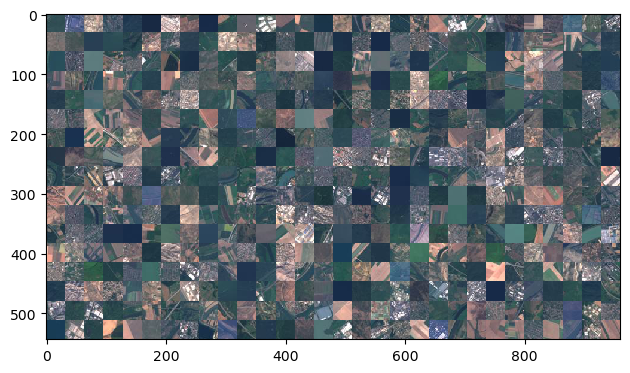

In [90]:
target_aspect_ratio = 16 / 9

num_images = len(images)
thumb_width, thumb_height = images[0].size

approx_cols = math.sqrt(num_images * target_aspect_ratio)
cols = max(1, int(approx_cols))

rows = math.ceil(num_images / cols)

total_images = rows * cols
if total_images > num_images:
    rows -= 1
    total_images = rows * cols

images = images[:total_images]

collage_width = cols * thumb_width
collage_height = rows * thumb_height
aspect_ratio = collage_width / collage_height

collage_image = Image.new('RGB', (collage_width, collage_height))

for idx, image in enumerate(images):
    x = (idx % cols) * thumb_width
    y = (idx // cols) * thumb_height
    collage_image.paste(image, (x, y))

collage_image.save("./generated_assets/eurosat_collage.jpeg")

imshow(imread("./generated_assets/eurosat_collage.jpeg"))